In [72]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt 
import numpy as np 

In [7]:
df=pd.read_csv("USA_Housing.csv",sep=',')

In [12]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [11]:
df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [10]:
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

## EDA

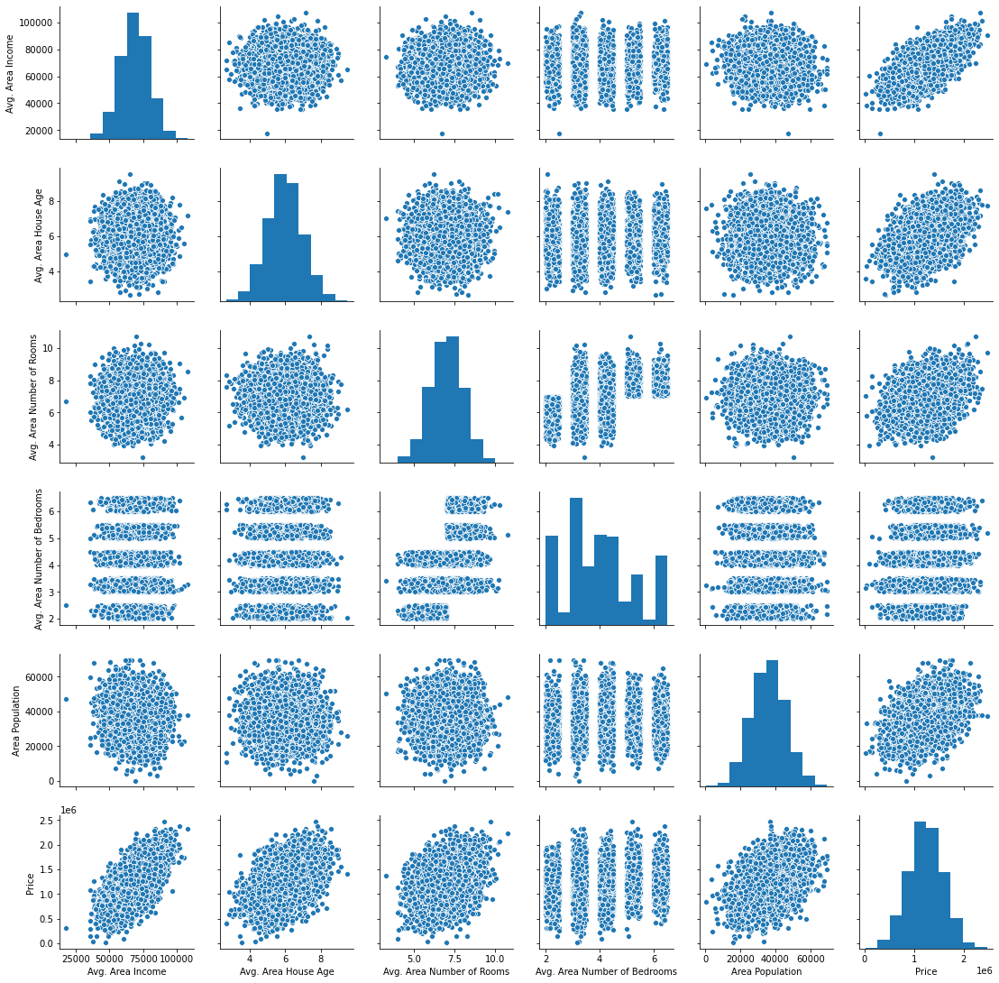

In [15]:
sns.pairplot(df)

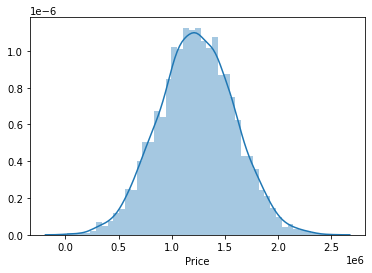

In [16]:
sns.distplot(df.Price)

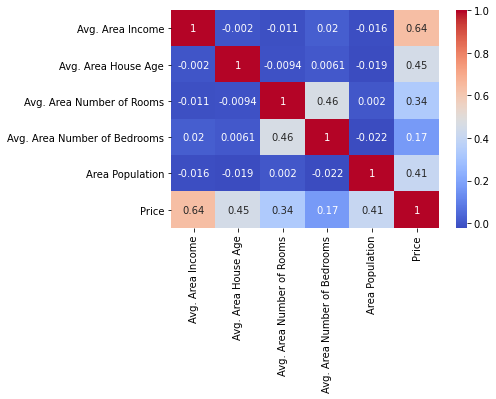

In [21]:
sns.heatmap(df.corr(),annot=True,cmap="coolwarm")

# Training Linear Regressin Model

In [46]:
X=df.drop(columns=["Address", "Price"])

In [47]:
y=df.Price

In [48]:
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


In [43]:
from sklearn.model_selection import train_test_split

In [53]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42)

In [54]:
X_train

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
4227,66547.016454,5.846095,6.847298,4.13,27850.822901
4676,53722.008599,6.401391,7.787764,3.30,47649.224665
800,64838.492899,6.437157,8.699544,4.02,32921.010068
3671,67097.092120,6.086754,7.211963,3.05,27191.506877
4193,75245.465436,8.167820,7.420100,3.42,37410.669928
...,...,...,...,...,...
4426,76223.561256,6.371627,5.342217,2.42,30165.337445
466,56685.014442,6.958045,7.502115,3.38,43322.166854
3092,66195.337714,6.507971,6.611861,3.14,37288.923574
3772,58694.515017,7.394768,9.269453,4.32,49960.977236


# Training Model

In [55]:
from sklearn.linear_model import LinearRegression

In [56]:
model= LinearRegression()

In [57]:
model.fit(X_train,y_train)

LinearRegression()

# Model Eveluate

In [59]:
print(model.intercept_) # value for y  when x=0

-2635072.9009312093


In [60]:
print(model.coef_)

[2.16522058e+01 1.64666481e+05 1.19624012e+05 2.44037761e+03
 1.52703134e+01]


In [61]:
coeff_df=pd.DataFrame(model.coef_,X.columns,columns=["Coefficient"])

In [62]:
coeff_df

,Coefficient
Avg. Area Income,21.652206
Avg. Area House Age,164666.480722
Avg. Area Number of Rooms,119624.012232
Avg. Area Number of Bedrooms,2440.377611
Area Population,15.270313


# Prediction

In [63]:
predictions=model.predict(X_test)

In [64]:
X_test["Prediction"]=predictions

In [65]:
X_test

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Prediction
1501,61907.593345,7.017838,6.440256,3.25,43828.947207,1.308588e+06
2586,57160.202243,6.893260,6.921532,3.13,43467.147035,1.237037e+06
2653,70190.796445,6.745054,6.662567,2.01,29215.136112,1.243429e+06
1055,69316.796889,6.300409,7.873576,4.28,24448.211461,1.228900e+06
705,72991.481649,3.412866,6.494081,2.48,50626.495426,1.063321e+06
...,...,...,...,...,...,...
4711,77267.656264,3.939501,8.342808,6.09,22487.712072,1.042903e+06
2313,75967.135085,5.939370,6.111658,2.32,38897.091584,1.318532e+06
3214,81013.615294,7.149797,7.239105,5.44,45472.049451,1.870001e+06
2732,86762.882864,6.530193,5.106962,2.09,47724.581355,1.663624e+06


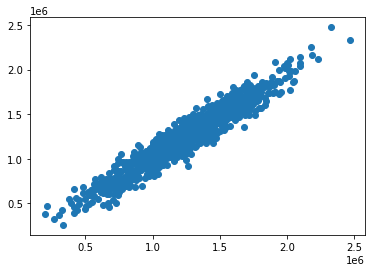

In [68]:
plt.scatter(y_test,predictions)

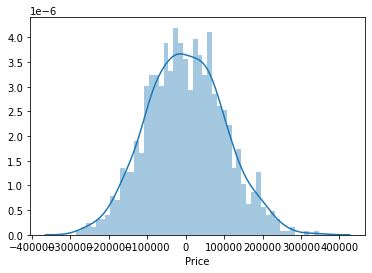

In [69]:
sns.distplot((y_test-predictions),bins=50)

# Evoluation Metrics

Case 1: Actual Values = [2,4,6,8] , Predicted Values = [4,6,8,10]
Case 2: Actual Values = [2,4,6,8] , Predicted Values = [4,6,8,12]



In [71]:
from sklearn import metrics

In [75]:
print("MAE",metrics.mean_absolute_error(y_test,predictions))
print("MSE",metrics.mean_squared_error(y_test,predictions))
print("RMSE",np.sqrt(metrics.mean_squared_error(y_test,predictions)))

MAE 80879.09723486961
MSE 10089009300.89066
RMSE 100444.06055556824
